In [4]:
import numpy as np  
from skimage.color import rgb2gray  
import matplotlib.pyplot as plt  
import cv2
np.set_printoptions(threshold=np.nan)
import sklearn.preprocessing

In [5]:
def get_harris_position(img,K = 0.04,threshold = 0.01):
    img = rgb2gray(img)
    height, width = np.shape(img)
    grandfx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)
    grandfy = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)  # compute the X direction and Y direction gradient 
    
    Ix2 = grandfx**2
    Iy2 = grandfy**2
    Ixy = grandfx*grandfy
    
    Ix2 = grandfx**2
    Iy2 = grandfy**2
    Ixy = grandfx*grandfy
    
    A = cv2.GaussianBlur(Ix2,(5,5),2)  # eliminate the noises
    B = cv2.GaussianBlur(Iy2,(5,5),2) 
    C = cv2.GaussianBlur(Ixy,(5,5),2)
    
    M = [np.array([[A[i, j], C[i, j]], #compute M
               [C[i, j], B[i, j]]]) for i in range(height) for j in range(width)]

    D, T = list(map(np.linalg.det, M)), list(map(np.trace, M))  #computer det(M) and trace(M)
    R = np.array([d-K*t**2 for d, t in zip(D, T)]) #computer R
    R_max = np.max(R)
    R = R.reshape(height, width)
    
    count = 0
    corners = []
    for i in range(1,height-1):  #computer whether Rij is the maximum value in a certain area and it is greater than the threshold*R_max
        for j in range(1,width-1):
            if R[i, j] > R_max*threshold:
                if R[i, j] == np.max(R[i-1:i+2, j-1:j+2]):
                    corners.append([i,j])
                    count += 1             
    corners = np.array(corners) #position of corners
    return corners

In [6]:
def show_corner(img,corners,K,threshold):
    fig, ax = plt.subplots()  # show corners
    ax.imshow(img, cmap=plt.cm.gray)
    ax.plot(corners[:, 1], corners[:, 0], '.b', markersize=8)
    plt.title('k = {}, threshold = {}'.format(K,threshold))
    plt.show()

In [7]:
# this function is to get keypoints and descriptors according to the given corners
# and assign them into cv2.KeyPoint for final drawing pictures
def get_patch(img, corners, patch_size):
    # initialize keypoints and descriptors
    keypoints, descriptors = [], []
    
    # take half of patchsize
    halfpatch = int(patch_size/2)
    
    for x, y in corners:
        # imgs are pedded, therefore x and y coordinates need to be changed according to the pedding pixels.
        x += pedding_pixels
        y += pedding_pixels
        
        keypoints.append(cv2.KeyPoint(y, x, patch_size))
        
        # descriptors are squares centered as x and y, halfpatch to each side.
        desc = img[x - halfpatch : x + halfpatch + 1,
                   y - halfpatch : y + halfpatch + 1]
        
        # normalization of descriptors
        desc = sklearn.preprocessing.normalize(desc)
        descriptors.append(desc.ravel())
        
    return np.array(keypoints), np.array(descriptors)

In [8]:
def ssd_match(des1, des2):
    # initialize matches_origin , matches after filtered, and statistic values as a dictionary
    matches_origin = []
    matches = []
    stats = {'matched_origin': 0, 'matched': 0,'std': 0, 'mean': 0}
    
    # loop through each patch in descriptors1
    for index, value in enumerate(des1):
        # Calculate SSD between descriptor[index] and all descriptors in des2
        ssd = np.sqrt(((value - des2) ** 2).sum(axis=1))
        # Get first best and second best indices
        first_index, second_index = np.argsort(ssd)[:2]
        # Get first best and second best SSD values
        first_value, second_value = ssd[first_index], ssd[second_index]
        
        # Check if ratio is at 'r'.
        # by plusing a very small number 10e-10 , to avoid denominator equals 0.
        if first_value / (float(second_value) + 10e-10) < r:
            # assign original match into a cv2.DMatch datastructure
            matches_origin.append(cv2.DMatch(index, first_index, first_value))
            # the number of matched_origin is added by one
            stats['matched_origin'] += 1
            # find the best match from des2[first_index] to all points in des1 by a reverse testing 
            ssd_re = np.sqrt(((des2[first_index] - des1) ** 2).sum(axis=1))
            index_re = np.argsort(ssd_re)[0]
            # Check whether the indices of the first_matches are the same
            # if the indices are the same, indicating they are the matched
            if index == index_re:
                matches.append(cv2.DMatch(index, first_index, first_value))
                # the number of matched is added by one
                stats['matched'] += 1
    # the SSDs between matches
    matched = [eachm.distance for eachm in matches]
    # calculate the stand diviation
    stats['std'] = np.std(matched)
    # calculate the mean 
    stats['mean'] = np.mean(matched)
    return matches_origin, matches, stats

In [9]:
def ssdstat(matches,stats):
    print('number of original matches:',stats['matched_origin'],'\n')
    print('number of matches:',stats['matched'],'\n')
    print('std of matches:', stats['std'],'\n')
    print('mean of matches:', stats['mean'],'\n')

In [28]:
# main programme

# the patch size, between 3-31, odd
patch_size_list = [5,7,9]

# the ratio between best match and the second match
r_list = [0.8,0.7,0.6]

# define how much pixels should be pedded:
pedding_pixels = 30

K = 0.04

threshold_list = [0.01,0.03,0.05,0.08,0.1]

filename1 = 'Img001_diffuse_smallgray.png'
filename2 = 'Img002_diffuse_smallgray.png'
filename9 = 'Img009_diffuse_smallgray.png'

img1 = cv2.imread(filename1,0)
img2 = cv2.imread(filename2,0)

def main(patch_size_list, r_list, pedding_pixels,K,threshold_list,img1,img2):
    for patch_size in patch_size_list:
        for r in r_list:
            for threshold in threshold_list:

                print('patch_size = {}'.format(patch_size))
                print('r = {}'.format(r))
                print('pedding_pixels =  {}'.format(pedding_pixels))
                print('k = {}'.format(K))
                print('threshold = {}'.format(threshold))

                # part 1 
                corners1 = get_harris_position(img1,threshold = threshold)
                corners2 = get_harris_position(img2,threshold = threshold)

                print("corners1",len(corners1))
                print("corners2",len(corners2))

                show_corner(img1,corners1,K,threshold)
                show_corner(img2,corners2,K,threshold)

                # part 2
                replicate_img1 = cv2.copyMakeBorder(img1,pedding_pixels,pedding_pixels,pedding_pixels,pedding_pixels,cv2.BORDER_REPLICATE)
                replicate_img2 = cv2.copyMakeBorder(img2,pedding_pixels,pedding_pixels,pedding_pixels,pedding_pixels,cv2.BORDER_REPLICATE)

                kps1, descriptors1 = get_patch(replicate_img1,corners1,patch_size)
                kps2, descriptors2 = get_patch(replicate_img2,corners2,patch_size)

                matches_origin12,matches12,stats12 = ssd_match(descriptors1,descriptors2)
    #             matches_origin21,matches21,stats21 = ssd_match(descriptors2,descriptors1)

                # drawlines
                plt.cla()
                img12 = cv2.drawMatches(replicate_img1, kps1, replicate_img2, kps2, matches12, None)
                plt.imshow(img12,cmap = "gray")
                plt.show()

                # stats
                total = ssdstat(matches12,stats12)
                
                print('----------------------------------------------------------')
            
    return corners1,corners2,img12

patch_size = 5
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.01
corners1 614
corners2 648


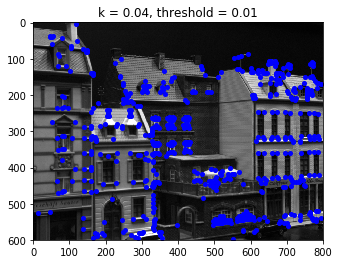

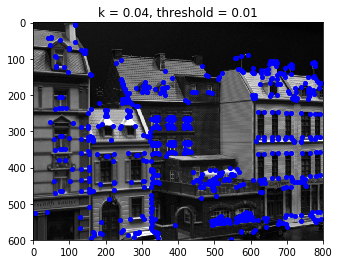

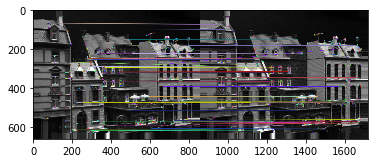

number of original matches: 80 

number of matches: 78 

std of matches: 0.04046399750548369 

mean of matches: 0.08853447920857714 

patch_size = 5
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.03
corners1 370
corners2 376


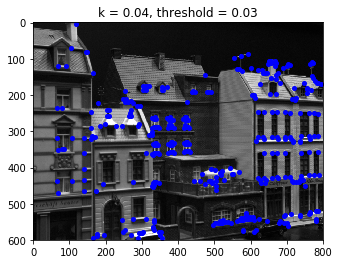

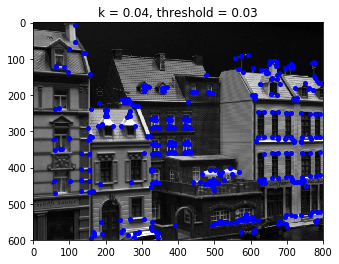

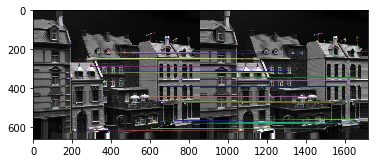

number of original matches: 55 

number of matches: 55 

std of matches: 0.04665600607377137 

mean of matches: 0.0936531634662639 

patch_size = 5
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


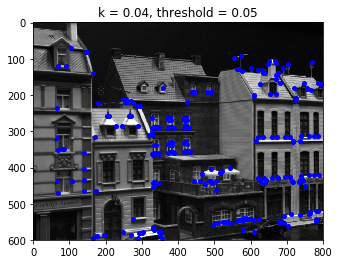

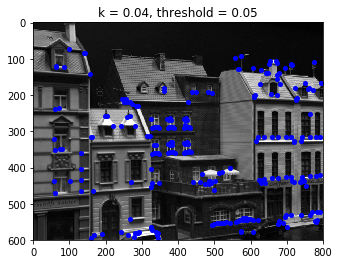

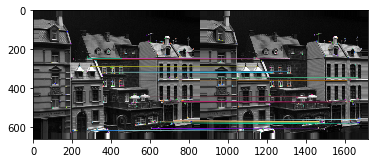

number of original matches: 38 

number of matches: 38 

std of matches: 0.044434777796724216 

mean of matches: 0.09995721711924202 

patch_size = 5
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.08
corners1 175
corners2 177


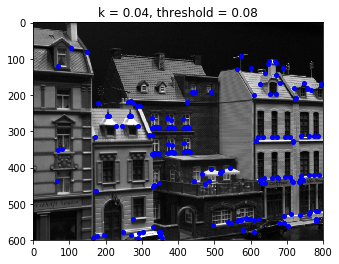

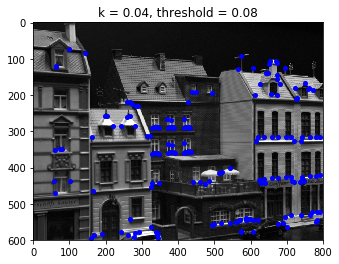

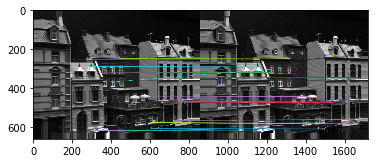

number of original matches: 33 

number of matches: 33 

std of matches: 0.043570849975985496 

mean of matches: 0.09577365761453455 

patch_size = 5
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.1
corners1 142
corners2 148


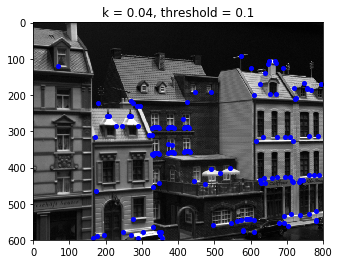

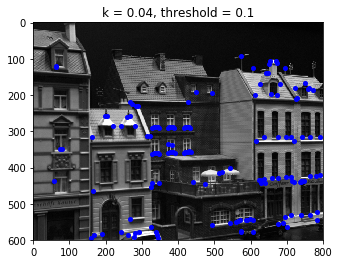

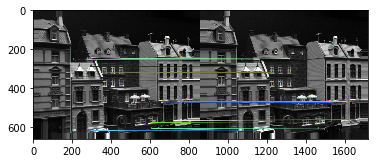

number of original matches: 28 

number of matches: 28 

std of matches: 0.0312975933901726 

mean of matches: 0.08909928000399045 

patch_size = 5
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.01
corners1 614
corners2 648


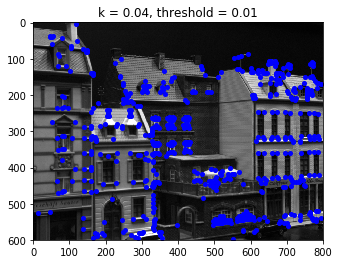

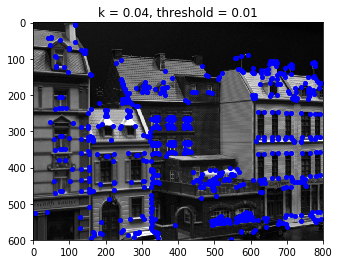

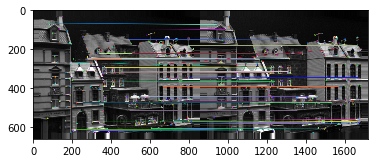

number of original matches: 80 

number of matches: 78 

std of matches: 0.04046399750548369 

mean of matches: 0.08853447920857714 

patch_size = 5
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.03
corners1 370
corners2 376


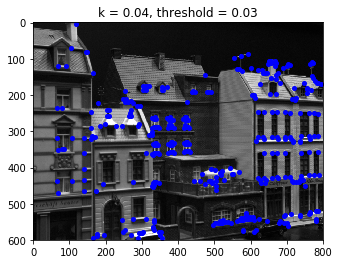

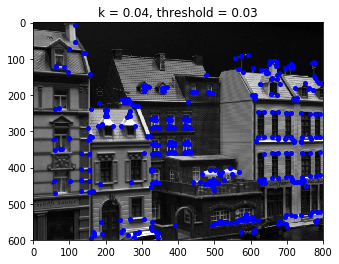

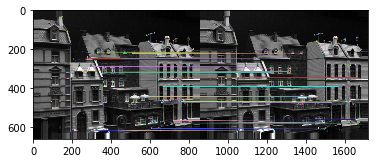

number of original matches: 55 

number of matches: 55 

std of matches: 0.04665600607377137 

mean of matches: 0.0936531634662639 

patch_size = 5
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


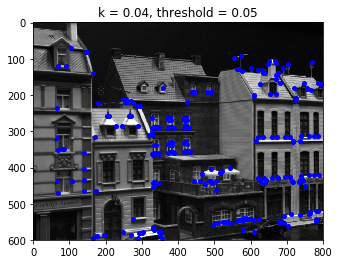

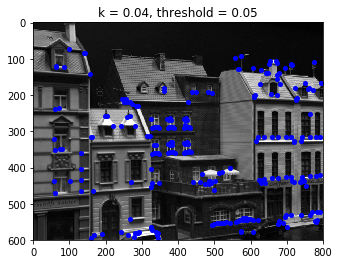

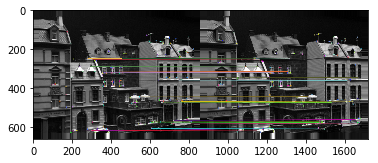

number of original matches: 38 

number of matches: 38 

std of matches: 0.044434777796724216 

mean of matches: 0.09995721711924202 

patch_size = 5
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.08
corners1 175
corners2 177


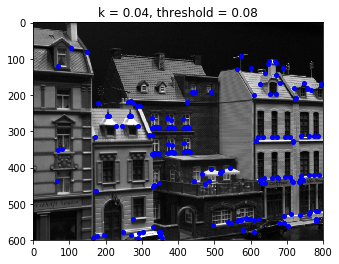

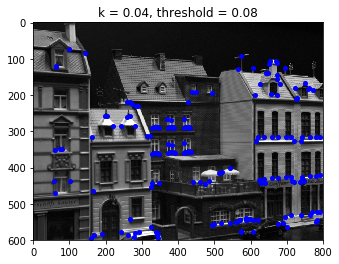

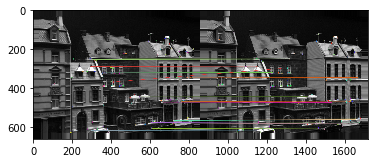

number of original matches: 33 

number of matches: 33 

std of matches: 0.043570849975985496 

mean of matches: 0.09577365761453455 

patch_size = 5
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.1
corners1 142
corners2 148


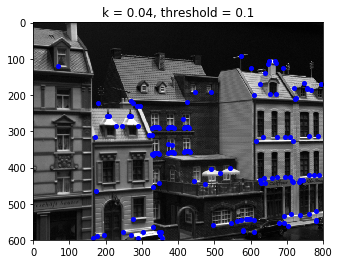

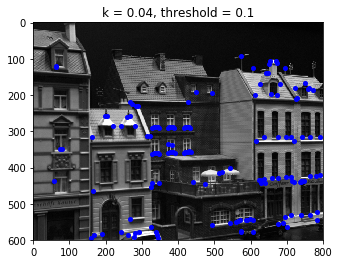

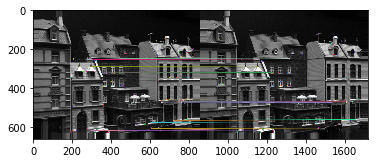

number of original matches: 28 

number of matches: 28 

std of matches: 0.0312975933901726 

mean of matches: 0.08909928000399045 

patch_size = 5
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.01
corners1 614
corners2 648


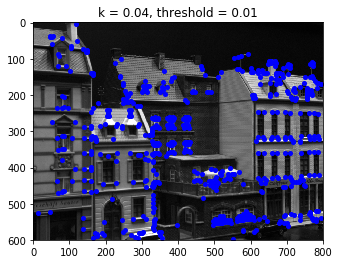

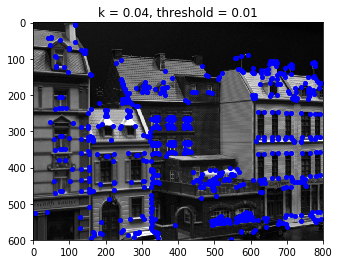

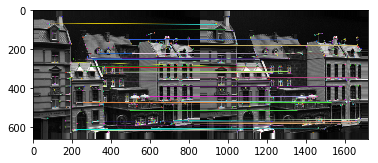

number of original matches: 80 

number of matches: 78 

std of matches: 0.04046399750548369 

mean of matches: 0.08853447920857714 

patch_size = 5
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.03
corners1 370
corners2 376


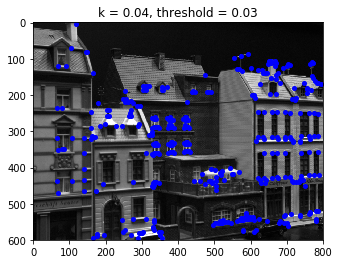

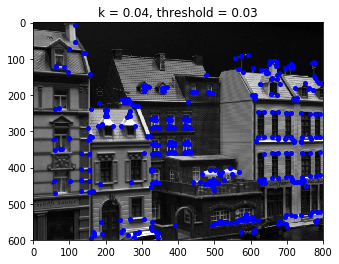

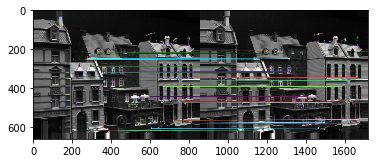

number of original matches: 55 

number of matches: 55 

std of matches: 0.04665600607377137 

mean of matches: 0.0936531634662639 

patch_size = 5
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


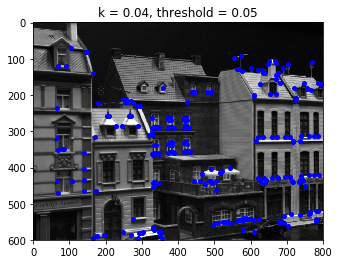

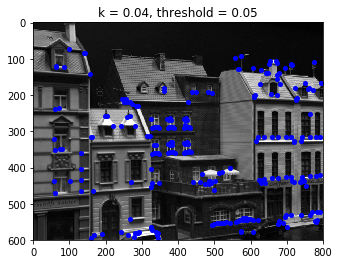

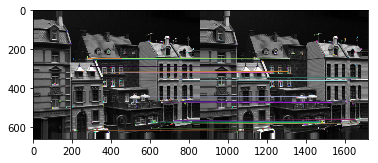

number of original matches: 38 

number of matches: 38 

std of matches: 0.044434777796724216 

mean of matches: 0.09995721711924202 

patch_size = 5
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.08
corners1 175
corners2 177


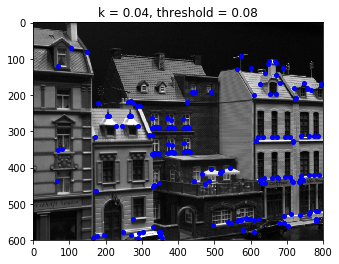

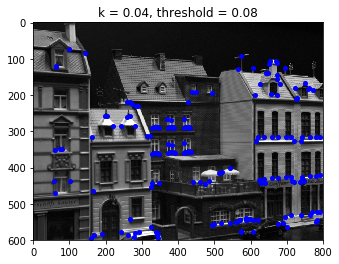

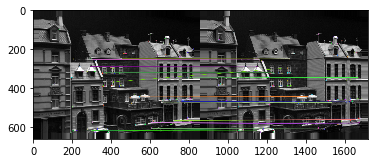

number of original matches: 33 

number of matches: 33 

std of matches: 0.043570849975985496 

mean of matches: 0.09577365761453455 

patch_size = 5
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.1
corners1 142
corners2 148


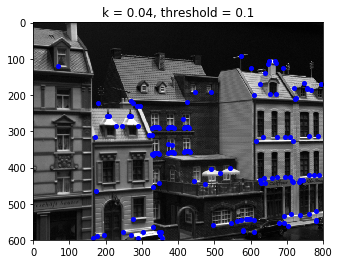

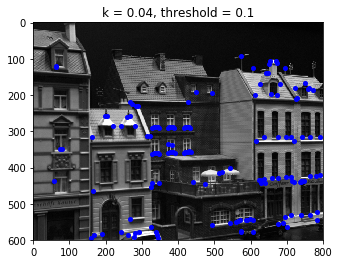

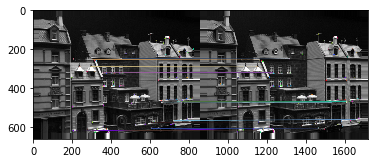

number of original matches: 28 

number of matches: 28 

std of matches: 0.0312975933901726 

mean of matches: 0.08909928000399045 

patch_size = 7
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.01
corners1 614
corners2 648


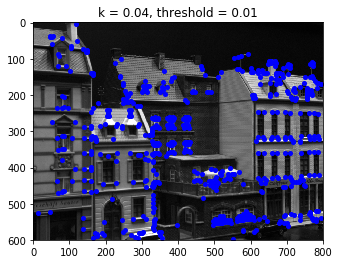

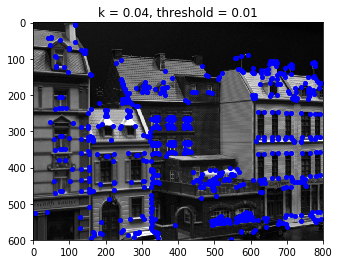

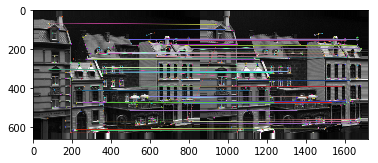

number of original matches: 126 

number of matches: 122 

std of matches: 0.07266800275010617 

mean of matches: 0.13899777244898628 

patch_size = 7
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.03
corners1 370
corners2 376


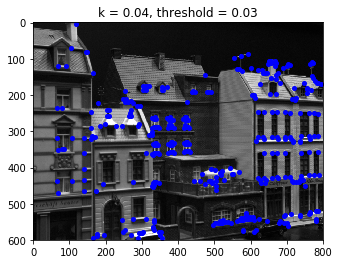

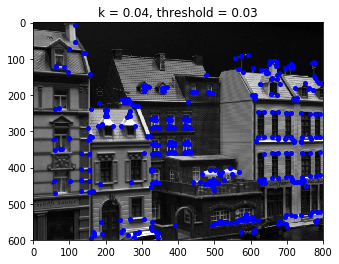

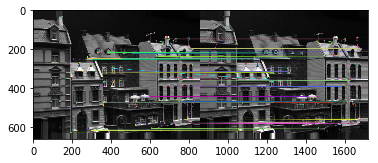

number of original matches: 77 

number of matches: 74 

std of matches: 0.07609250336990504 

mean of matches: 0.14140474078925075 

patch_size = 7
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


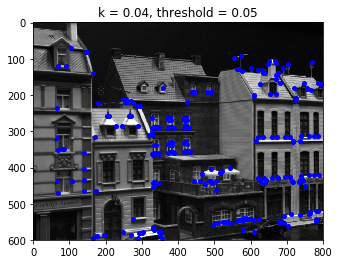

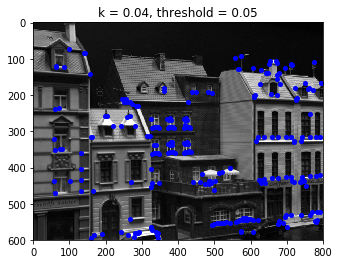

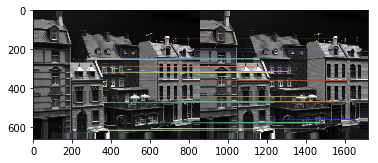

number of original matches: 57 

number of matches: 55 

std of matches: 0.06461835857210668 

mean of matches: 0.14625592611052773 

patch_size = 7
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.08
corners1 175
corners2 177


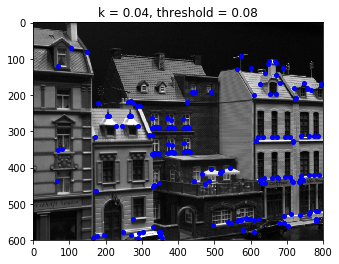

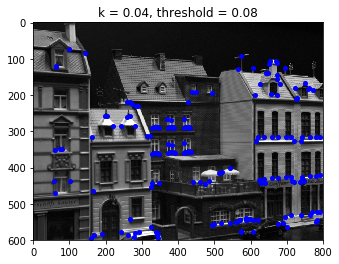

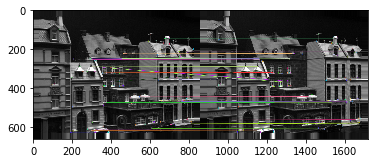

number of original matches: 48 

number of matches: 45 

std of matches: 0.06413612422185597 

mean of matches: 0.14623111138741177 

patch_size = 7
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.1
corners1 142
corners2 148


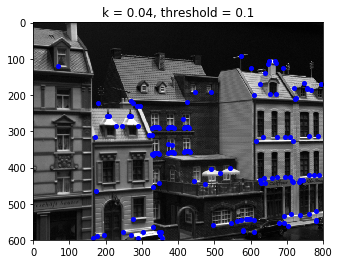

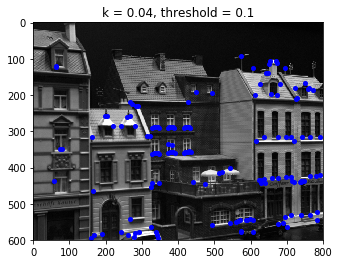

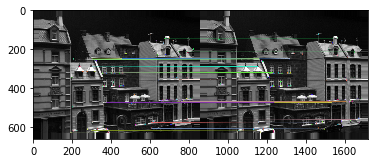

number of original matches: 37 

number of matches: 36 

std of matches: 0.057889364991596755 

mean of matches: 0.13851695445676646 

patch_size = 7
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.01
corners1 614
corners2 648


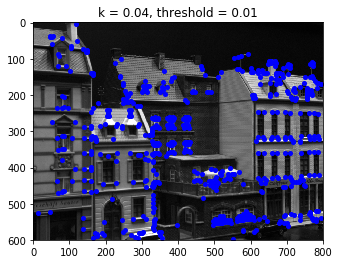

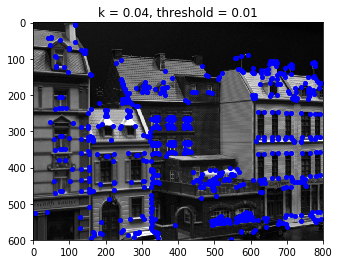

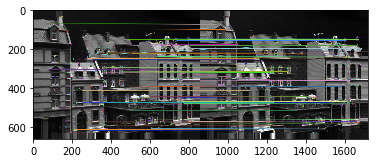

number of original matches: 126 

number of matches: 122 

std of matches: 0.07266800275010617 

mean of matches: 0.13899777244898628 

patch_size = 7
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.03
corners1 370
corners2 376


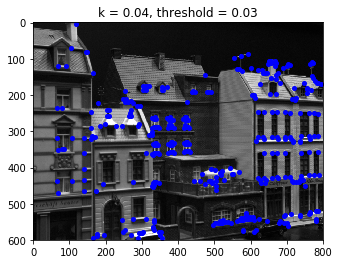

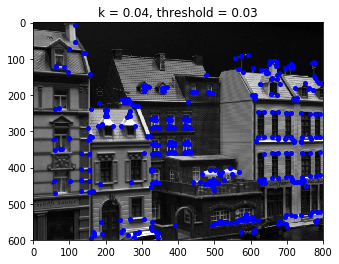

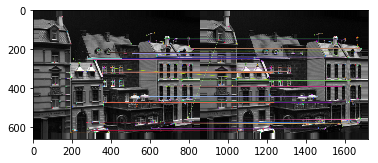

number of original matches: 77 

number of matches: 74 

std of matches: 0.07609250336990504 

mean of matches: 0.14140474078925075 

patch_size = 7
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


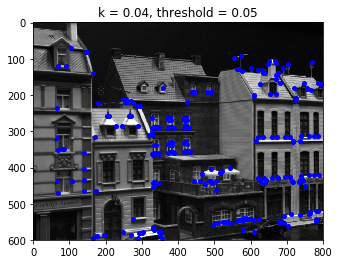

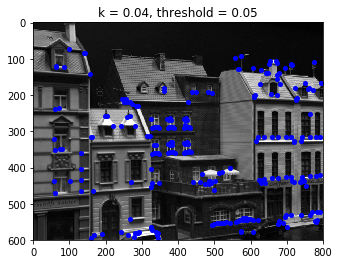

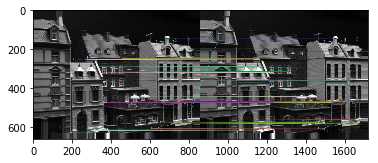

number of original matches: 57 

number of matches: 55 

std of matches: 0.06461835857210668 

mean of matches: 0.14625592611052773 

patch_size = 7
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.08
corners1 175
corners2 177


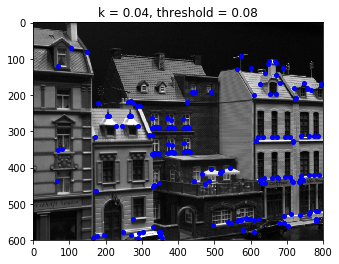

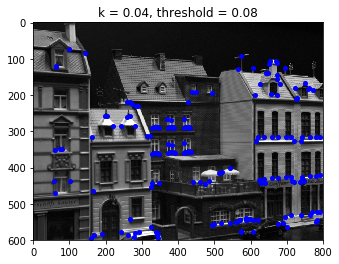

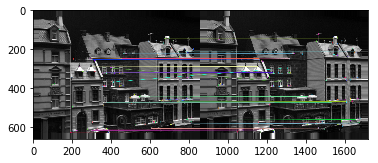

number of original matches: 48 

number of matches: 45 

std of matches: 0.06413612422185597 

mean of matches: 0.14623111138741177 

patch_size = 7
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.1
corners1 142
corners2 148


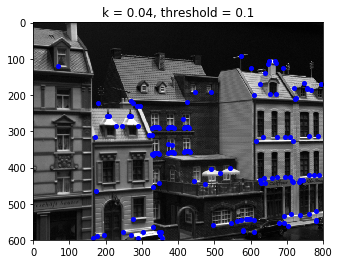

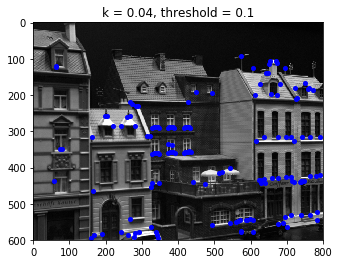

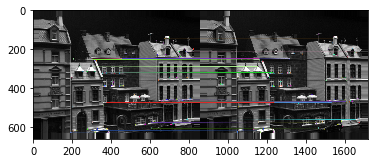

number of original matches: 37 

number of matches: 36 

std of matches: 0.057889364991596755 

mean of matches: 0.13851695445676646 

patch_size = 7
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.01
corners1 614
corners2 648


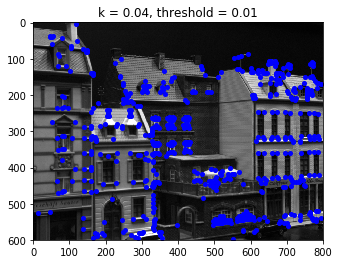

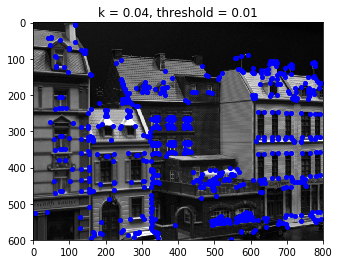

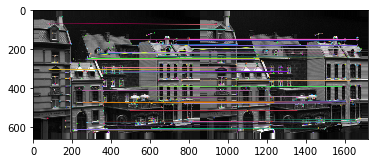

number of original matches: 126 

number of matches: 122 

std of matches: 0.07266800275010617 

mean of matches: 0.13899777244898628 

patch_size = 7
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.03
corners1 370
corners2 376


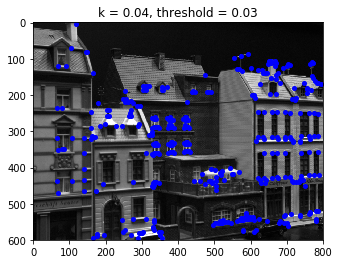

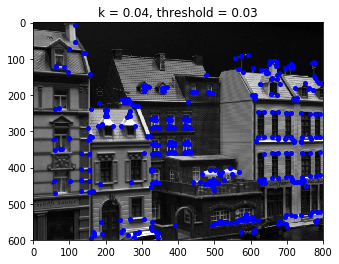

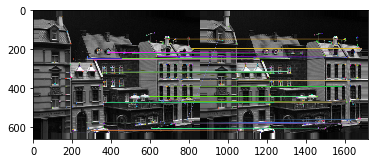

number of original matches: 77 

number of matches: 74 

std of matches: 0.07609250336990504 

mean of matches: 0.14140474078925075 

patch_size = 7
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


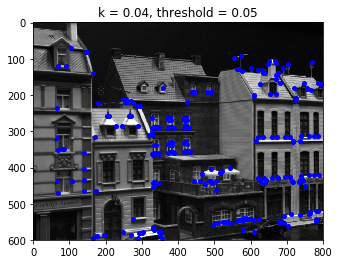

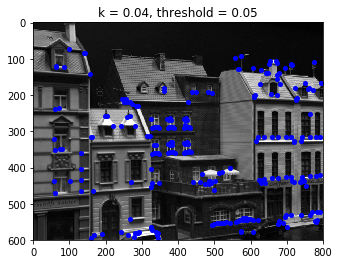

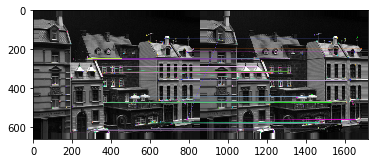

number of original matches: 57 

number of matches: 55 

std of matches: 0.06461835857210668 

mean of matches: 0.14625592611052773 

patch_size = 7
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.08
corners1 175
corners2 177


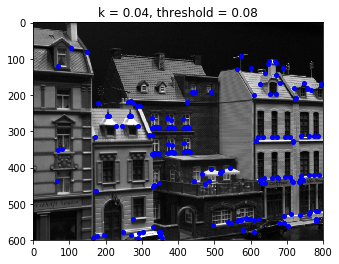

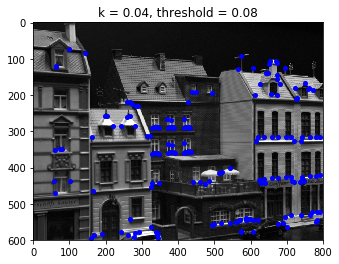

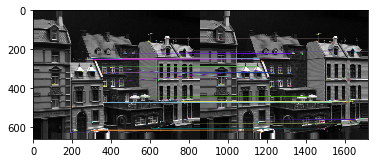

number of original matches: 48 

number of matches: 45 

std of matches: 0.06413612422185597 

mean of matches: 0.14623111138741177 

patch_size = 7
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.1
corners1 142
corners2 148


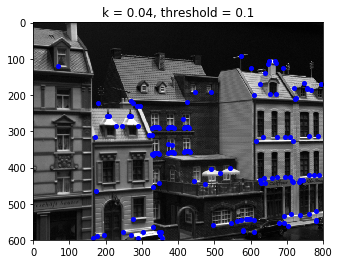

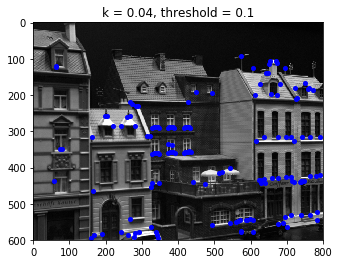

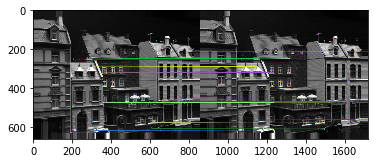

number of original matches: 37 

number of matches: 36 

std of matches: 0.057889364991596755 

mean of matches: 0.13851695445676646 

patch_size = 9
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.01
corners1 614
corners2 648


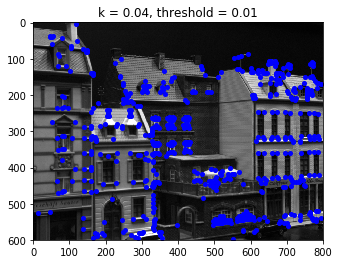

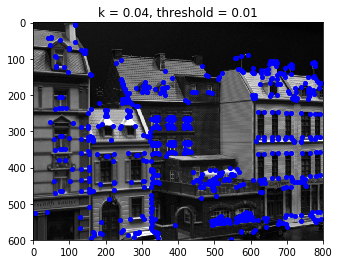

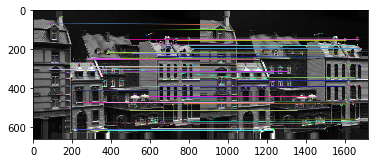

number of original matches: 148 

number of matches: 146 

std of matches: 0.08139146873974792 

mean of matches: 0.17360234870384 

patch_size = 9
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.03
corners1 370
corners2 376


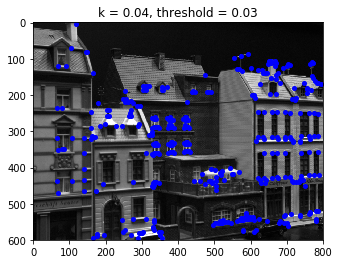

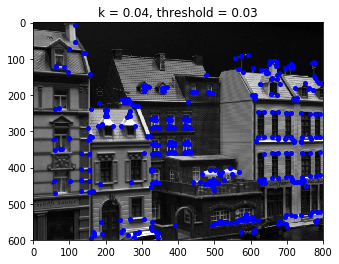

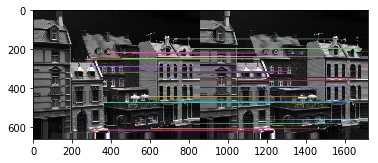

number of original matches: 90 

number of matches: 88 

std of matches: 0.0816906565443742 

mean of matches: 0.17694207191975278 

patch_size = 9
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


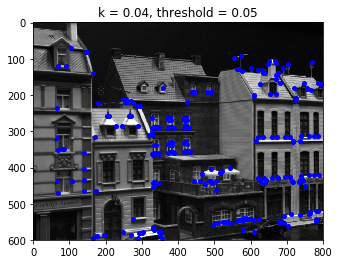

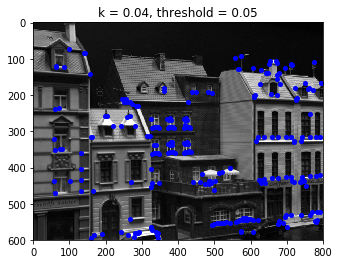

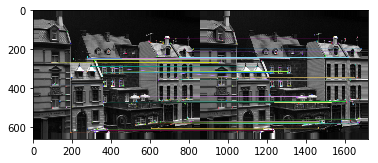

number of original matches: 68 

number of matches: 67 

std of matches: 0.06640649588477655 

mean of matches: 0.18497171986903718 

patch_size = 9
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.08
corners1 175
corners2 177


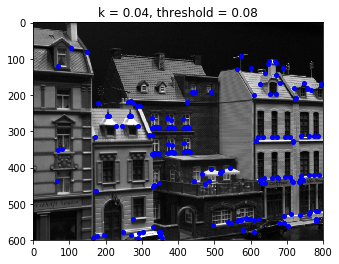

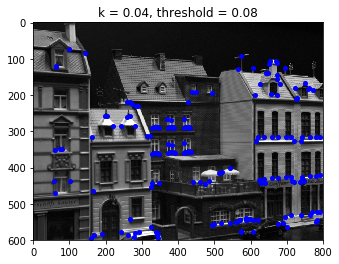

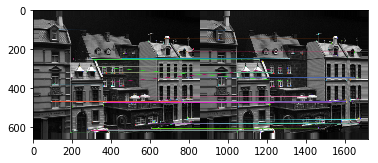

number of original matches: 54 

number of matches: 53 

std of matches: 0.06418277616229955 

mean of matches: 0.18551077988912473 

patch_size = 9
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.1
corners1 142
corners2 148


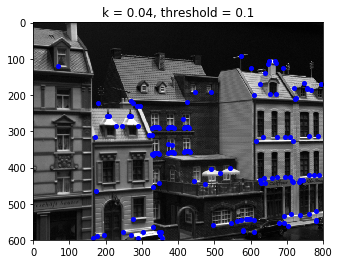

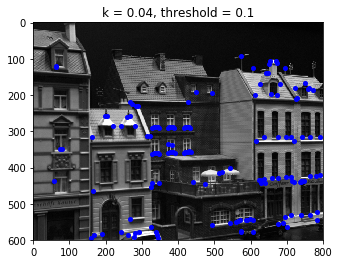

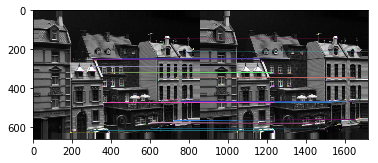

number of original matches: 45 

number of matches: 45 

std of matches: 0.07336164039000377 

mean of matches: 0.1859322945276896 

patch_size = 9
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.01
corners1 614
corners2 648


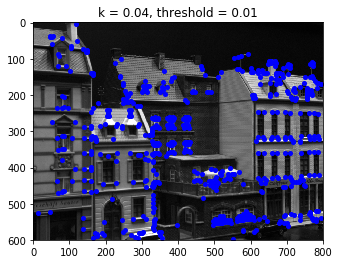

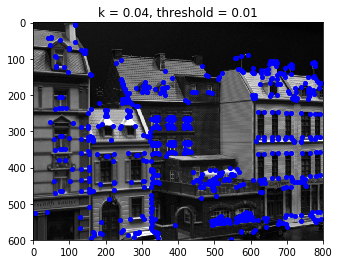

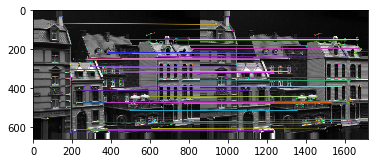

number of original matches: 148 

number of matches: 146 

std of matches: 0.08139146873974792 

mean of matches: 0.17360234870384 

patch_size = 9
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.03
corners1 370
corners2 376


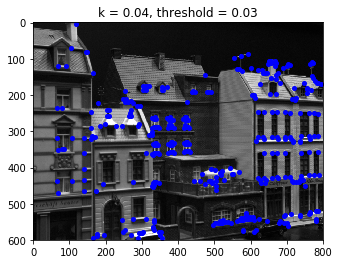

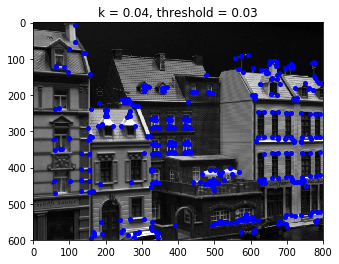

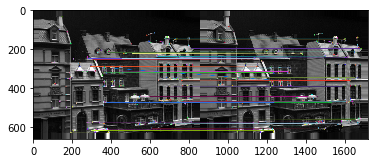

number of original matches: 90 

number of matches: 88 

std of matches: 0.0816906565443742 

mean of matches: 0.17694207191975278 

patch_size = 9
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


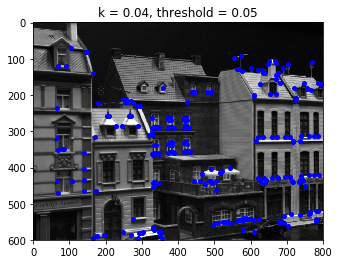

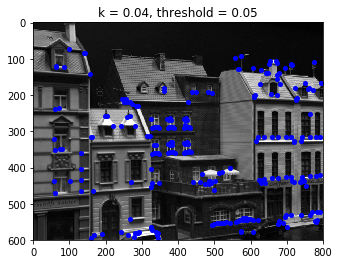

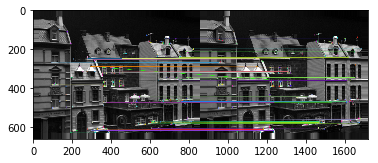

number of original matches: 68 

number of matches: 67 

std of matches: 0.06640649588477655 

mean of matches: 0.18497171986903718 

patch_size = 9
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.08
corners1 175
corners2 177


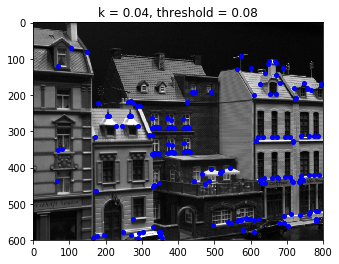

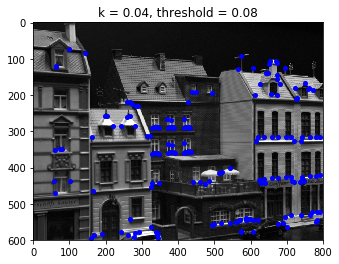

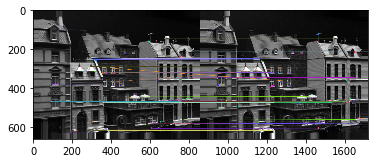

number of original matches: 54 

number of matches: 53 

std of matches: 0.06418277616229955 

mean of matches: 0.18551077988912473 

patch_size = 9
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.1
corners1 142
corners2 148


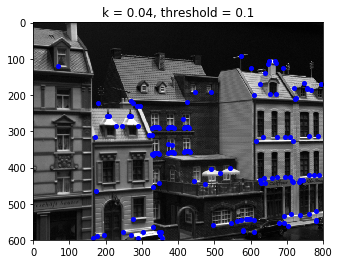

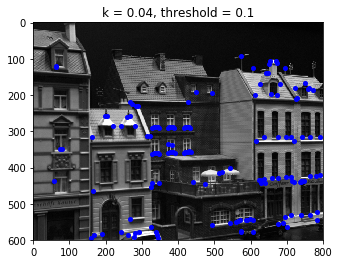

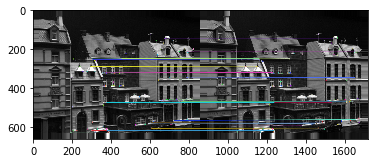

number of original matches: 45 

number of matches: 45 

std of matches: 0.07336164039000377 

mean of matches: 0.1859322945276896 

patch_size = 9
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.01
corners1 614
corners2 648


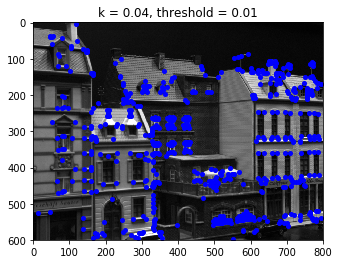

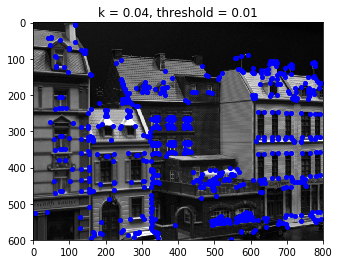

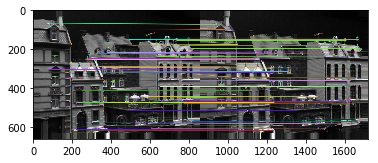

number of original matches: 148 

number of matches: 146 

std of matches: 0.08139146873974792 

mean of matches: 0.17360234870384 

patch_size = 9
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.03
corners1 370
corners2 376


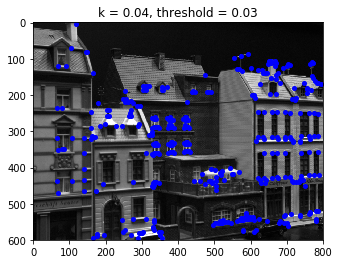

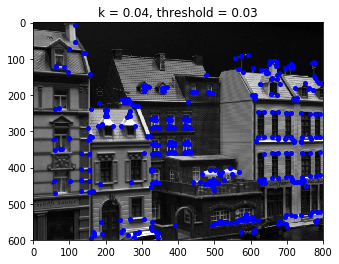

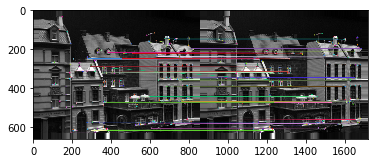

number of original matches: 90 

number of matches: 88 

std of matches: 0.0816906565443742 

mean of matches: 0.17694207191975278 

patch_size = 9
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


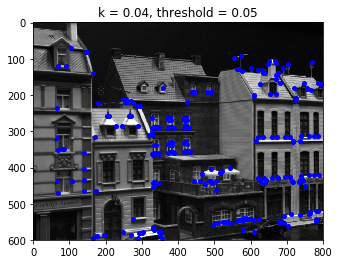

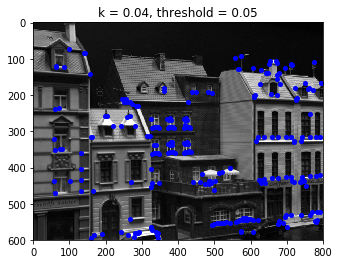

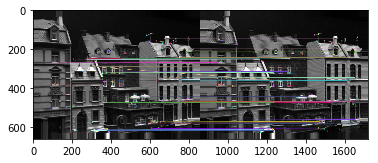

number of original matches: 68 

number of matches: 67 

std of matches: 0.06640649588477655 

mean of matches: 0.18497171986903718 

patch_size = 9
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.08
corners1 175
corners2 177


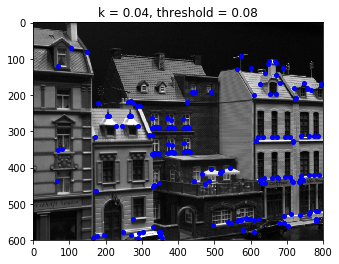

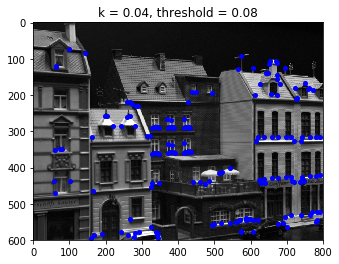

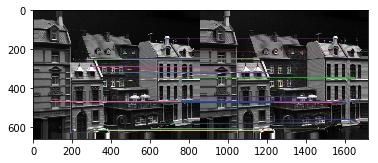

number of original matches: 54 

number of matches: 53 

std of matches: 0.06418277616229955 

mean of matches: 0.18551077988912473 

patch_size = 9
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.1
corners1 142
corners2 148


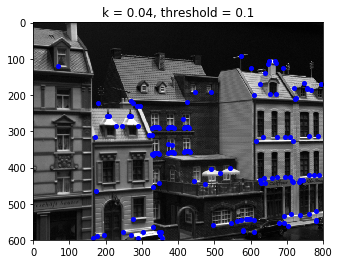

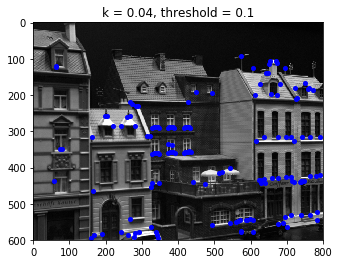

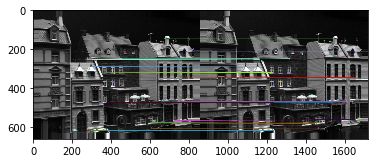

number of original matches: 45 

number of matches: 45 

std of matches: 0.07336164039000377 

mean of matches: 0.1859322945276896 



In [29]:
# second trying, using different patch_sizes,rs,thresholds
corners1, corners2,img12 = main(patch_size_list, r_list, pedding_pixels, K, threshold_list, img1, img2)

patch_size = 3
r = 0.95
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


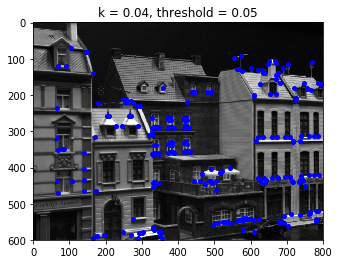

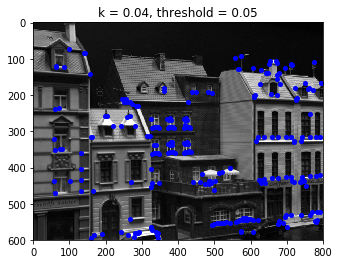

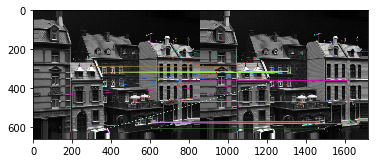

number of original matches: 31 

number of matches: 28 

std of matches: 0.025180389473046155 

mean of matches: 0.04405133050334241 

patch_size = 3
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


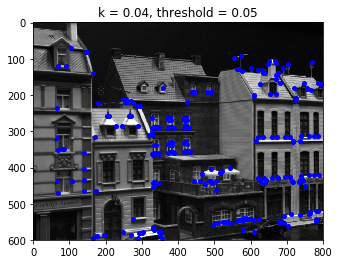

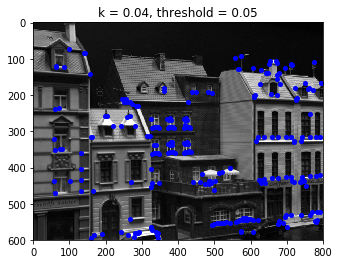

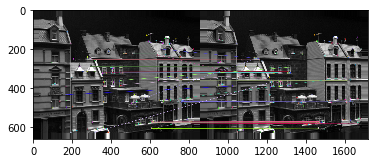

number of original matches: 31 

number of matches: 28 

std of matches: 0.025180389473046155 

mean of matches: 0.04405133050334241 

patch_size = 3
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


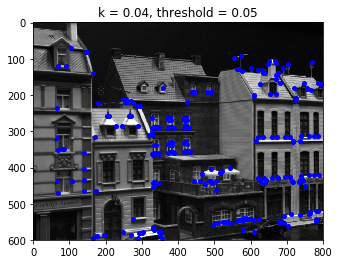

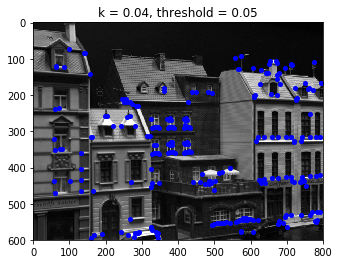

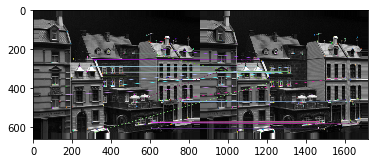

number of original matches: 31 

number of matches: 28 

std of matches: 0.025180389473046155 

mean of matches: 0.04405133050334241 

patch_size = 3
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


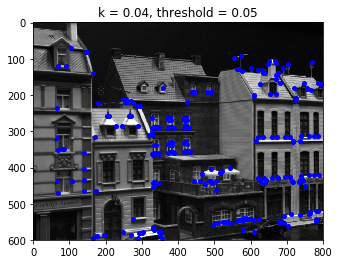

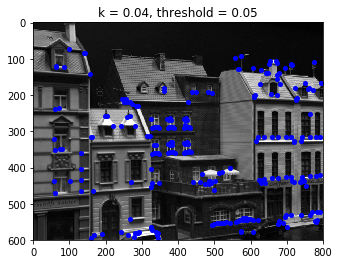

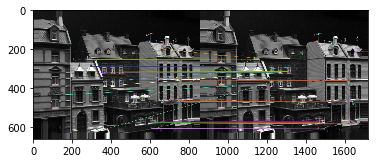

number of original matches: 31 

number of matches: 28 

std of matches: 0.025180389473046155 

mean of matches: 0.04405133050334241 

patch_size = 3
r = 0.5
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


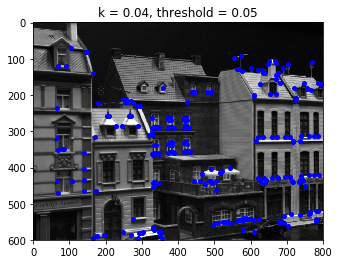

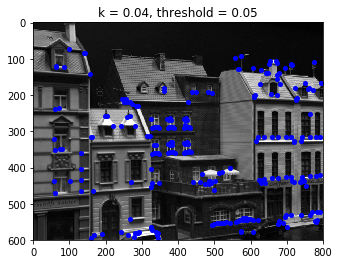

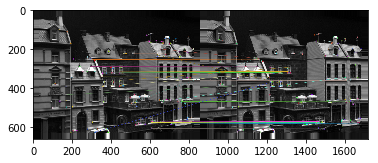

number of original matches: 31 

number of matches: 28 

std of matches: 0.025180389473046155 

mean of matches: 0.04405133050334241 

patch_size = 5
r = 0.95
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


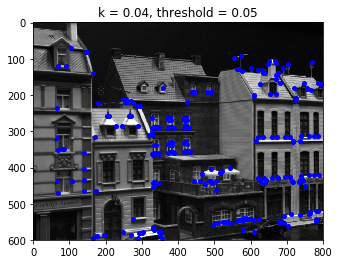

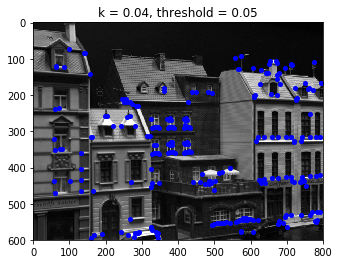

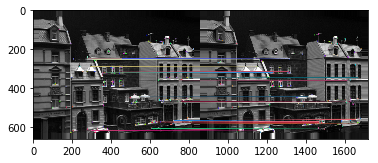

number of original matches: 38 

number of matches: 38 

std of matches: 0.044434777796724216 

mean of matches: 0.09995721711924202 

patch_size = 5
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


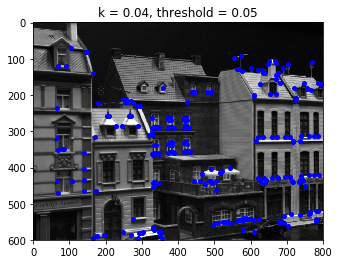

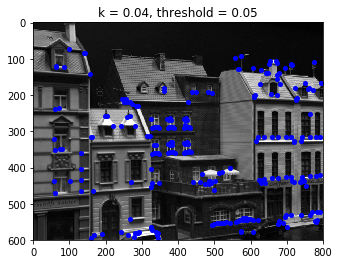

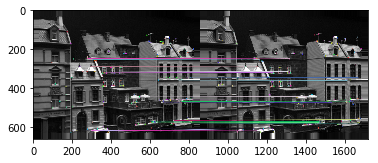

number of original matches: 38 

number of matches: 38 

std of matches: 0.044434777796724216 

mean of matches: 0.09995721711924202 

patch_size = 5
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


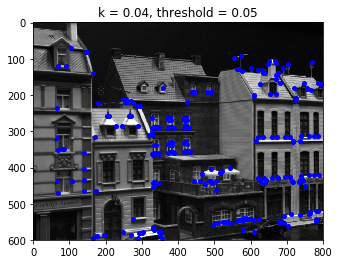

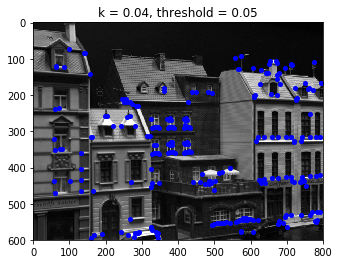

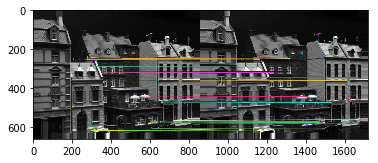

number of original matches: 38 

number of matches: 38 

std of matches: 0.044434777796724216 

mean of matches: 0.09995721711924202 

patch_size = 5
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


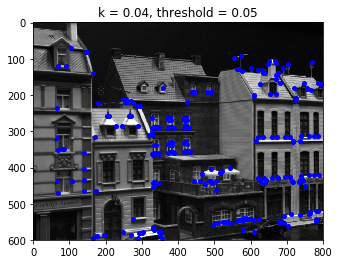

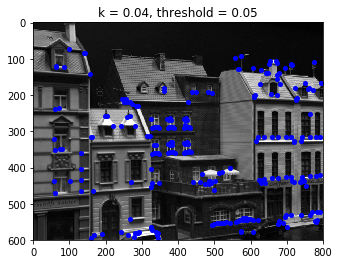

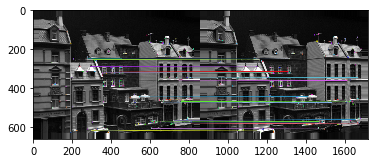

number of original matches: 38 

number of matches: 38 

std of matches: 0.044434777796724216 

mean of matches: 0.09995721711924202 

patch_size = 5
r = 0.5
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


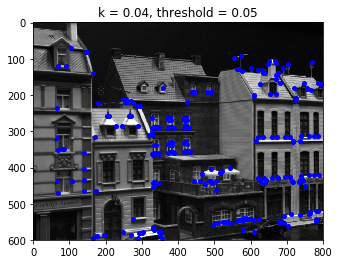

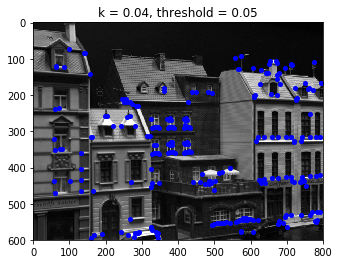

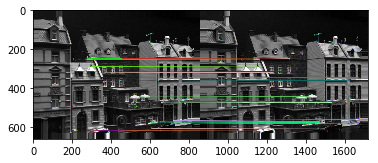

number of original matches: 38 

number of matches: 38 

std of matches: 0.044434777796724216 

mean of matches: 0.09995721711924202 

patch_size = 7
r = 0.95
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


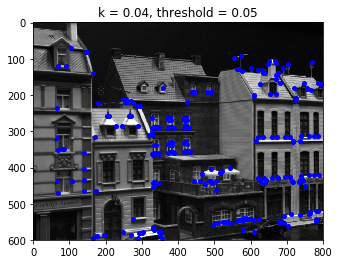

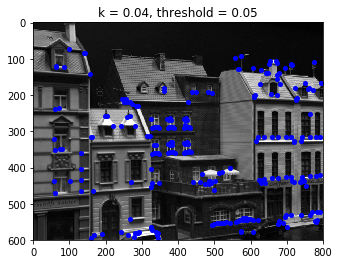

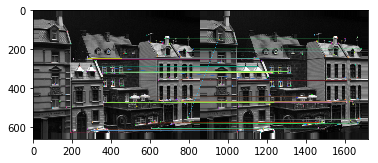

number of original matches: 57 

number of matches: 55 

std of matches: 0.06461835857210668 

mean of matches: 0.14625592611052773 

patch_size = 7
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


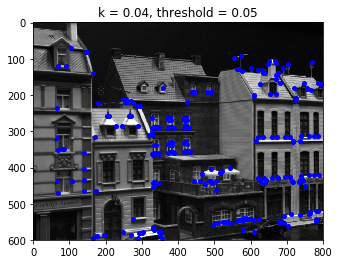

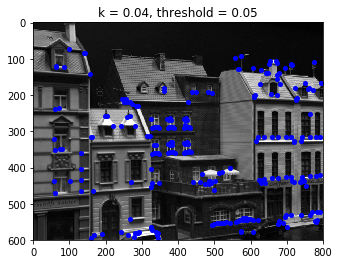

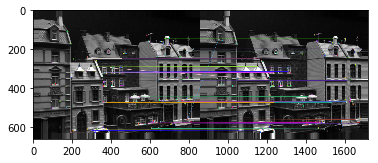

number of original matches: 57 

number of matches: 55 

std of matches: 0.06461835857210668 

mean of matches: 0.14625592611052773 

patch_size = 7
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


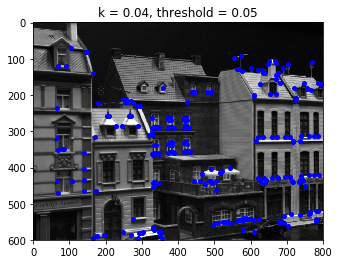

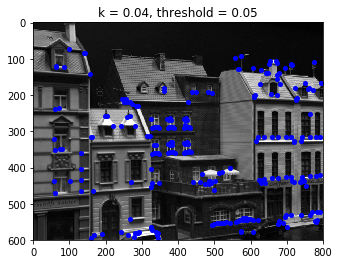

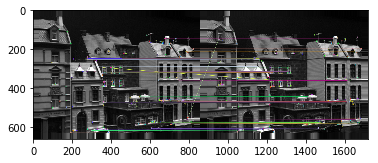

number of original matches: 57 

number of matches: 55 

std of matches: 0.06461835857210668 

mean of matches: 0.14625592611052773 

patch_size = 7
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


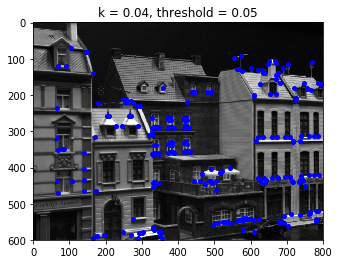

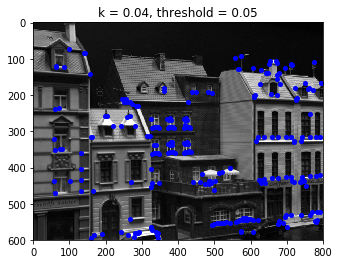

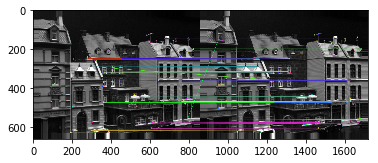

number of original matches: 57 

number of matches: 55 

std of matches: 0.06461835857210668 

mean of matches: 0.14625592611052773 

patch_size = 7
r = 0.5
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


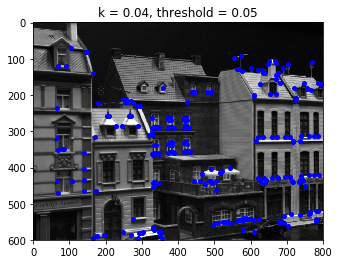

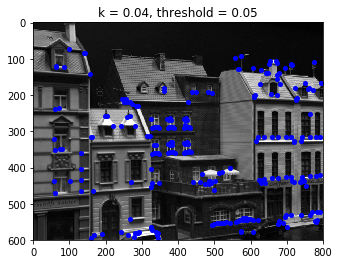

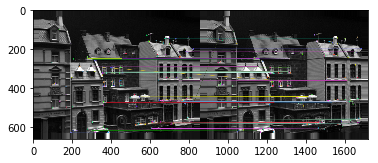

number of original matches: 57 

number of matches: 55 

std of matches: 0.06461835857210668 

mean of matches: 0.14625592611052773 

patch_size = 9
r = 0.95
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


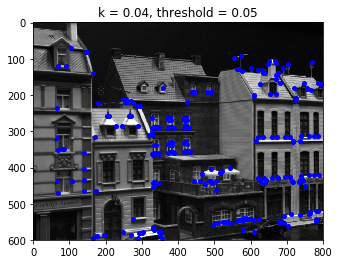

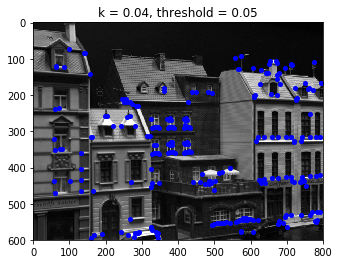

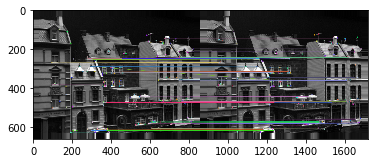

number of original matches: 68 

number of matches: 67 

std of matches: 0.06640649588477655 

mean of matches: 0.18497171986903718 

patch_size = 9
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


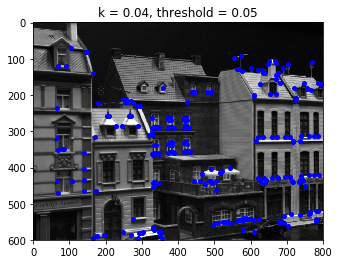

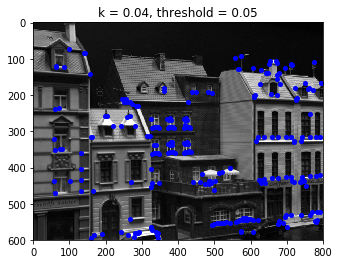

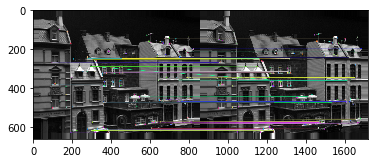

number of original matches: 68 

number of matches: 67 

std of matches: 0.06640649588477655 

mean of matches: 0.18497171986903718 

patch_size = 9
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


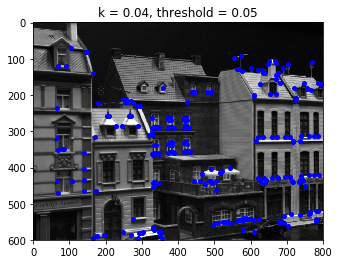

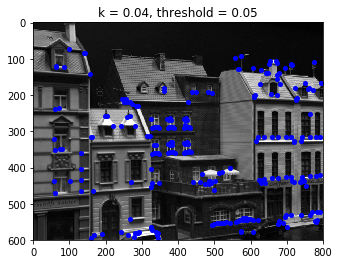

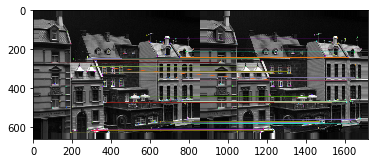

number of original matches: 68 

number of matches: 67 

std of matches: 0.06640649588477655 

mean of matches: 0.18497171986903718 

patch_size = 9
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


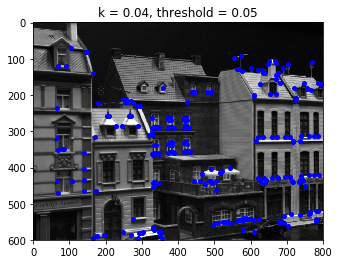

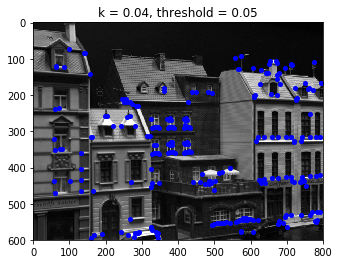

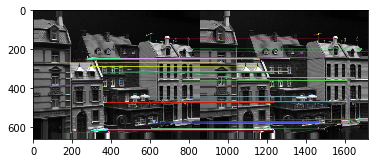

number of original matches: 68 

number of matches: 67 

std of matches: 0.06640649588477655 

mean of matches: 0.18497171986903718 

patch_size = 9
r = 0.5
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


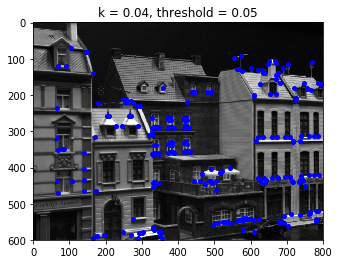

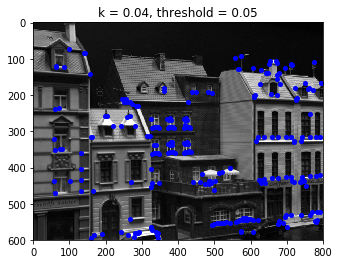

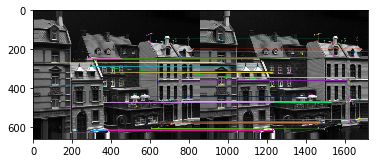

number of original matches: 68 

number of matches: 67 

std of matches: 0.06640649588477655 

mean of matches: 0.18497171986903718 

patch_size = 13
r = 0.95
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


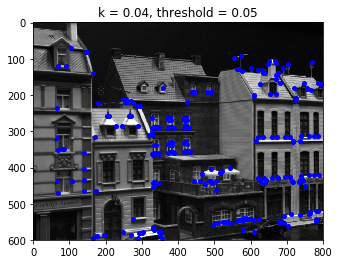

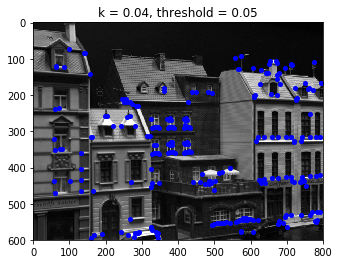

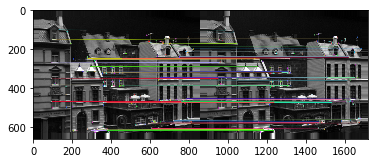

number of original matches: 96 

number of matches: 95 

std of matches: 0.1121409033770055 

mean of matches: 0.28030718188536796 

patch_size = 13
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


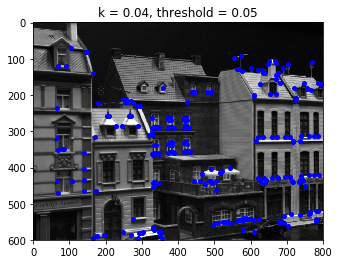

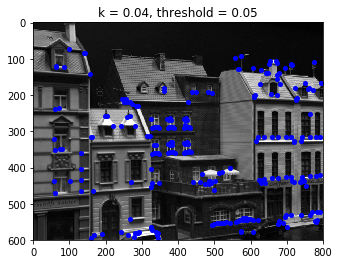

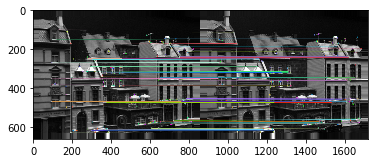

number of original matches: 96 

number of matches: 95 

std of matches: 0.1121409033770055 

mean of matches: 0.28030718188536796 

patch_size = 13
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


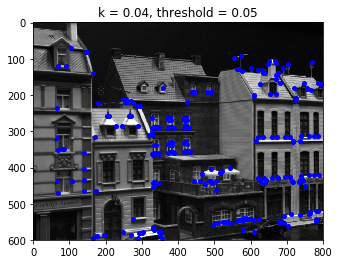

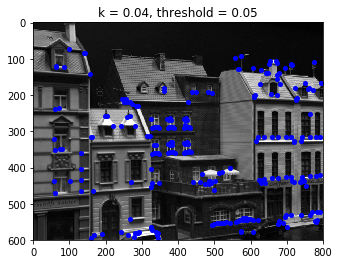

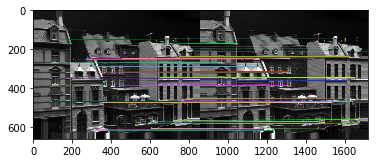

number of original matches: 96 

number of matches: 95 

std of matches: 0.1121409033770055 

mean of matches: 0.28030718188536796 

patch_size = 13
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


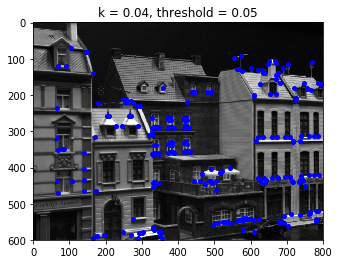

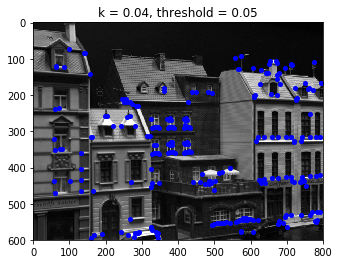

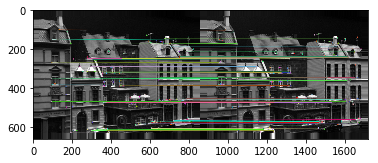

number of original matches: 96 

number of matches: 95 

std of matches: 0.1121409033770055 

mean of matches: 0.28030718188536796 

patch_size = 13
r = 0.5
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


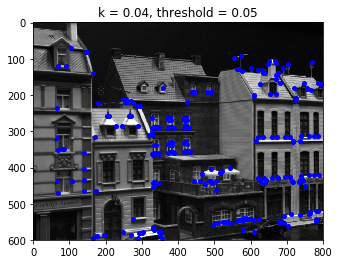

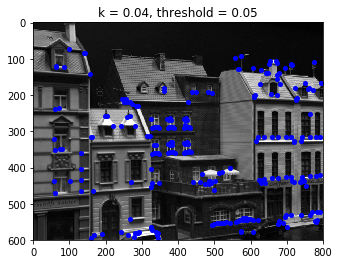

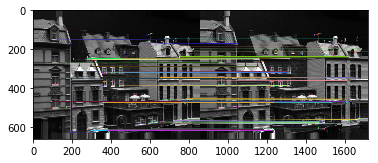

number of original matches: 96 

number of matches: 95 

std of matches: 0.1121409033770055 

mean of matches: 0.28030718188536796 

patch_size = 21
r = 0.95
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


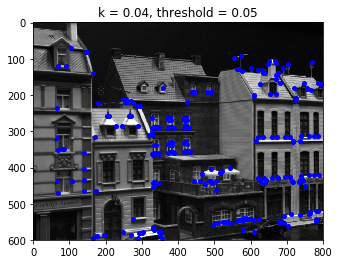

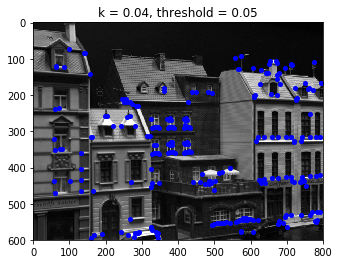

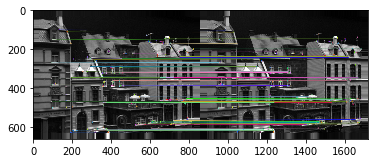

number of original matches: 113 

number of matches: 113 

std of matches: 0.17384046966421604 

mean of matches: 0.4123463687379803 

patch_size = 21
r = 0.8
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


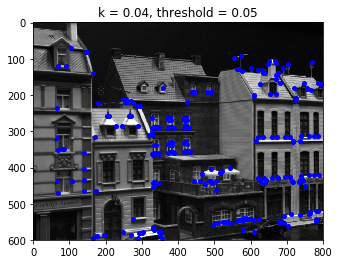

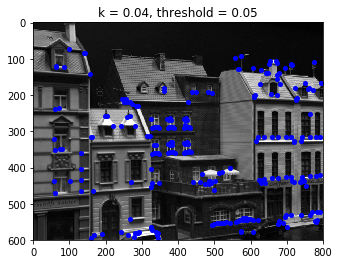

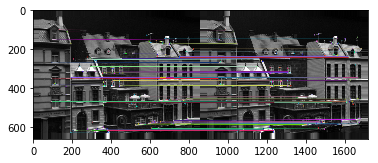

number of original matches: 113 

number of matches: 113 

std of matches: 0.17384046966421604 

mean of matches: 0.4123463687379803 

patch_size = 21
r = 0.7
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


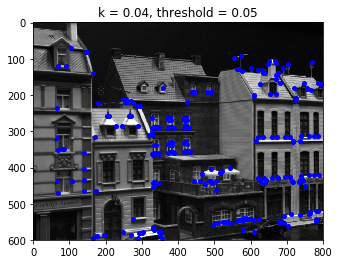

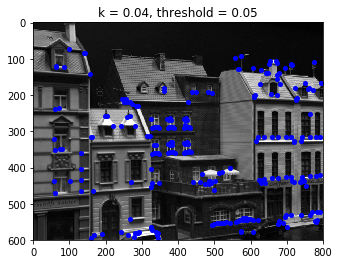

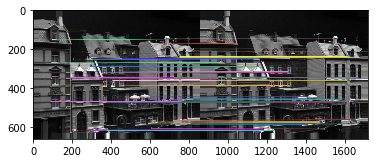

number of original matches: 113 

number of matches: 113 

std of matches: 0.17384046966421604 

mean of matches: 0.4123463687379803 

patch_size = 21
r = 0.6
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


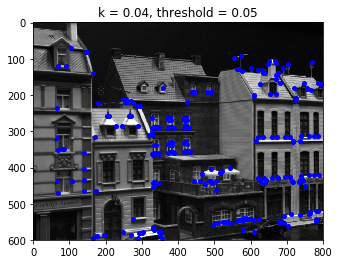

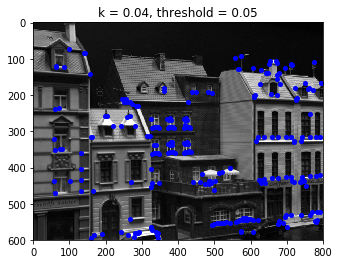

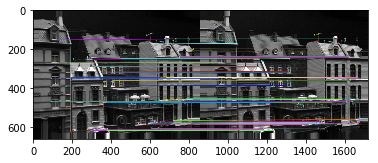

number of original matches: 113 

number of matches: 113 

std of matches: 0.17384046966421604 

mean of matches: 0.4123463687379803 

patch_size = 21
r = 0.5
pedding_pixels =  30
k = 0.04
threshold = 0.05
corners1 247
corners2 249


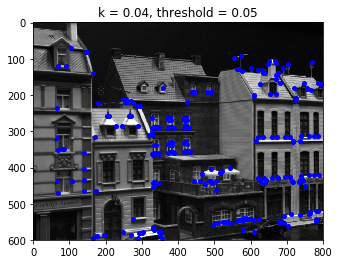

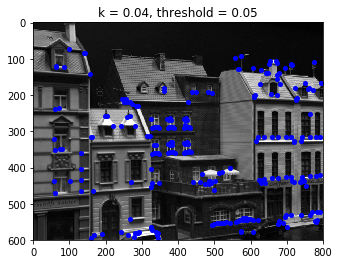

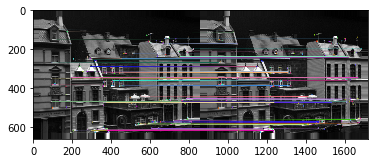

number of original matches: 113 

number of matches: 113 

std of matches: 0.17384046966421604 

mean of matches: 0.4123463687379803 



ValueError: not enough values to unpack (expected 6, got 5)

In [21]:
# first trying, using different patch_sizes,rs,but with fixed threshold = 0.05
corners1, corners2,img12 = main(patch_size_list, r_list, pedding_pixels, K, threshold, img1, img2)